# Выбор локации для скважины

Допустим, вы работаете в добывающей компании «ГлавРосГосНефть». Нужно решить, где бурить новую скважину.

Вам предоставлены пробы нефти в трёх регионах: в каждом 10 000 месторождений, где измерили качество нефти и объём её запасов. Постройте модель машинного обучения, которая поможет определить регион, где добыча принесёт наибольшую прибыль. Проанализируйте возможную прибыль и риски техникой *Bootstrap.*

Шаги для выбора локации:

- В избранном регионе ищут месторождения, для каждого определяют значения признаков;
- Строят модель и оценивают объём запасов;
- Выбирают месторождения с самым высокими оценками значений. Количество месторождений зависит от бюджета компании и стоимости разработки одной скважины;
- Прибыль равна суммарной прибыли отобранных месторождений.

## Описание данных

Данные геологоразведки трёх регионов находятся в файлах: 

- /datasets/geo_data_0.csv. Скачать датасет
- /datasets/geo_data_1.csv. Скачать датасет
- /datasets/geo_data_2.csv. Скачать датасет
- id — уникальный идентификатор скважины;
- f0, f1, f2 — три признака точек (неважно, что они означают, но сами признаки значимы);
- product — объём запасов в скважине (тыс. баррелей).

## Условия задачи:

- Для обучения модели подходит только линейная регрессия (остальные — недостаточно предсказуемые).

- При разведке региона исследуют 500 точек, из которых с помощью машинного обучения выбирают 200 лучших для разработки.

- Бюджет на разработку скважин в регионе — 10 млрд рублей.

- При нынешних ценах один баррель сырья приносит 450 рублей дохода. Доход с каждой единицы продукта составляет 450 тыс. рублей,      поскольку объём указан в тысячах баррелей.

- После оценки рисков нужно оставить лишь те регионы, в которых вероятность убытков меньше 2.5%.  Среди них выбирают регион с    наибольшей средней прибылью.  

Данные синтетические: детали контрактов и характеристики месторождений не разглашаются.

## Цель исследования

 Цель исследования — разработать  модель машинного обучения, которая поможет определить регион, где добыча принесёт наибольшую прибыль.

## Ход исследования:

   1. Загрузка и подготовка данных.
   2. Обучение и проверка модели.
   3. Подготовка к расчёту прибыли.
   4. Расчёт прибыли и рисков.
   5. Общий вывод.

In [30]:
# установка модулей
# !pip install -Uq scikit-learn
# !pip install phik

In [31]:
# импорт библиотеки

from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

import pandas as pd
import numpy as np


from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import root_mean_squared_error

from scipy import stats as st
from scipy.stats import binom, norm

from phik.report import plot_correlation_matrix
from phik import report

import matplotlib.pyplot as plt 
import seaborn as sns
import plotly.express as px

import warnings
warnings.filterwarnings("ignore")

pd.set_option('display.max_columns',None)
pd.options.mode.chained_assignment=None

In [32]:
RANDOM_STATE = 42
TEST_SIZE = 0.25

## Шаг 1. Загрузите и подготовьте данные. Поясните порядок действий.

In [33]:

geo_data_0 = pd.read_csv('https://code.s3.yandex.net/datasets/geo_data_0.csv')
geo_data_1 = pd.read_csv('https://code.s3.yandex.net/datasets/geo_data_1.csv')
geo_data_2 = pd.read_csv('https://code.s3.yandex.net/datasets/geo_data_2.csv')

In [34]:
def info_df(df):
    print(df.head())                    
    print(df.info())
    print('подсчёт явных дубликатов:',df.duplicated().sum())
    print('Количество уникальные записи id:',df['id'].nunique())

In [35]:
info_df(geo_data_0)

      id        f0        f1        f2     product
0  txEyH  0.705745 -0.497823  1.221170  105.280062
1  2acmU  1.334711 -0.340164  4.365080   73.037750
2  409Wp  1.022732  0.151990  1.419926   85.265647
3  iJLyR -0.032172  0.139033  2.978566  168.620776
4  Xdl7t  1.988431  0.155413  4.751769  154.036647
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 5 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   id       100000 non-null  object 
 1   f0       100000 non-null  float64
 2   f1       100000 non-null  float64
 3   f2       100000 non-null  float64
 4   product  100000 non-null  float64
dtypes: float64(4), object(1)
memory usage: 3.8+ MB
None
подсчёт явных дубликатов: 0
Количество уникальные записи id: 99990


In [36]:
info_df(geo_data_1)

      id         f0         f1        f2     product
0  kBEdx -15.001348  -8.276000 -0.005876    3.179103
1  62mP7  14.272088  -3.475083  0.999183   26.953261
2  vyE1P   6.263187  -5.948386  5.001160  134.766305
3  KcrkZ -13.081196 -11.506057  4.999415  137.945408
4  AHL4O  12.702195  -8.147433  5.004363  134.766305
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 5 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   id       100000 non-null  object 
 1   f0       100000 non-null  float64
 2   f1       100000 non-null  float64
 3   f2       100000 non-null  float64
 4   product  100000 non-null  float64
dtypes: float64(4), object(1)
memory usage: 3.8+ MB
None
подсчёт явных дубликатов: 0
Количество уникальные записи id: 99996


In [37]:
info_df(geo_data_2)

      id        f0        f1        f2     product
0  fwXo0 -1.146987  0.963328 -0.828965   27.758673
1  WJtFt  0.262778  0.269839 -2.530187   56.069697
2  ovLUW  0.194587  0.289035 -5.586433   62.871910
3  q6cA6  2.236060 -0.553760  0.930038  114.572842
4  WPMUX -0.515993  1.716266  5.899011  149.600746
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 5 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   id       100000 non-null  object 
 1   f0       100000 non-null  float64
 2   f1       100000 non-null  float64
 3   f2       100000 non-null  float64
 4   product  100000 non-null  float64
dtypes: float64(4), object(1)
memory usage: 3.8+ MB
None
подсчёт явных дубликатов: 0
Количество уникальные записи id: 99996


In [38]:
# Функция для корреляционного анализа
def correlation_matrix_phik(df):
    df=df.drop(['id'],axis=1)
    interval_cols = df.select_dtypes(include=['number']).columns.to_list()



    phik_overview = df.phik_matrix(interval_cols=interval_cols)
    plot_correlation_matrix(
    phik_overview.values,
    x_labels=phik_overview.columns,
    y_labels=phik_overview.index,
    vmin=0, vmax=1, color_map='Greens',
    title=r"correlation $\phi_K$",
    fontsize_factor=1.5,
    figsize=(15, 12))

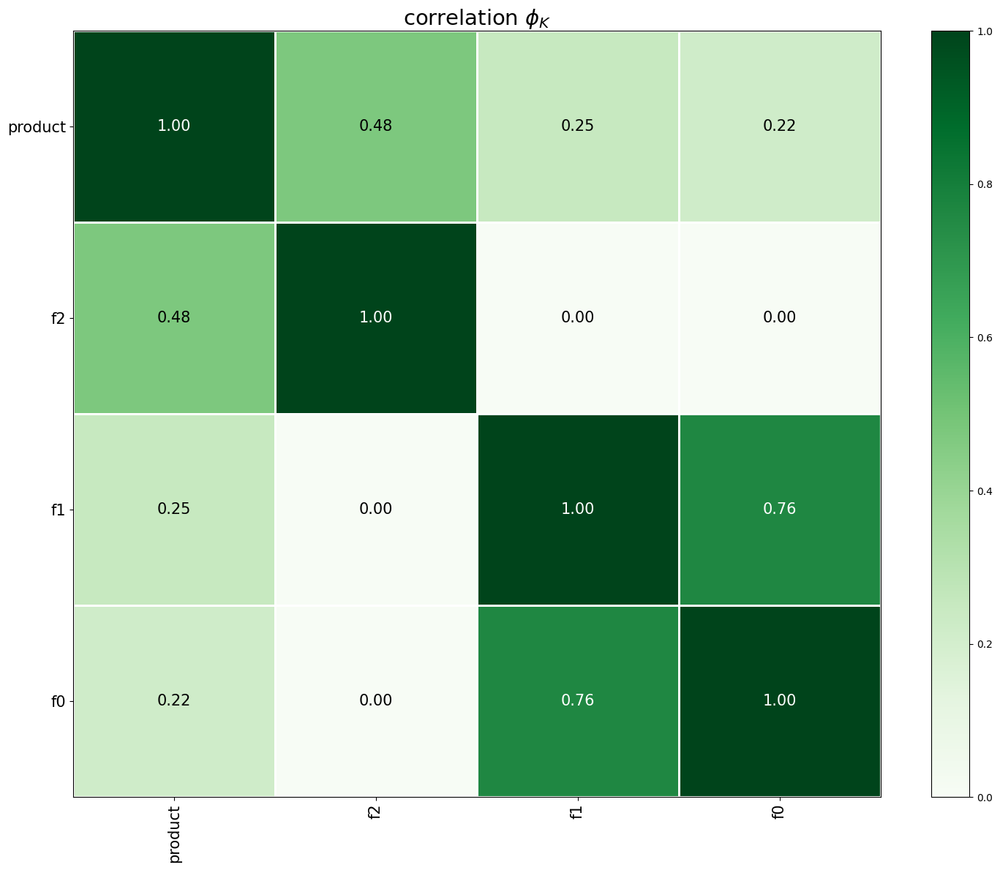

In [39]:
correlation_matrix_phik(geo_data_0)

<b>Вывод</b>

- Наблюдается мултиколлтнеарность между признаками f0 и f1.

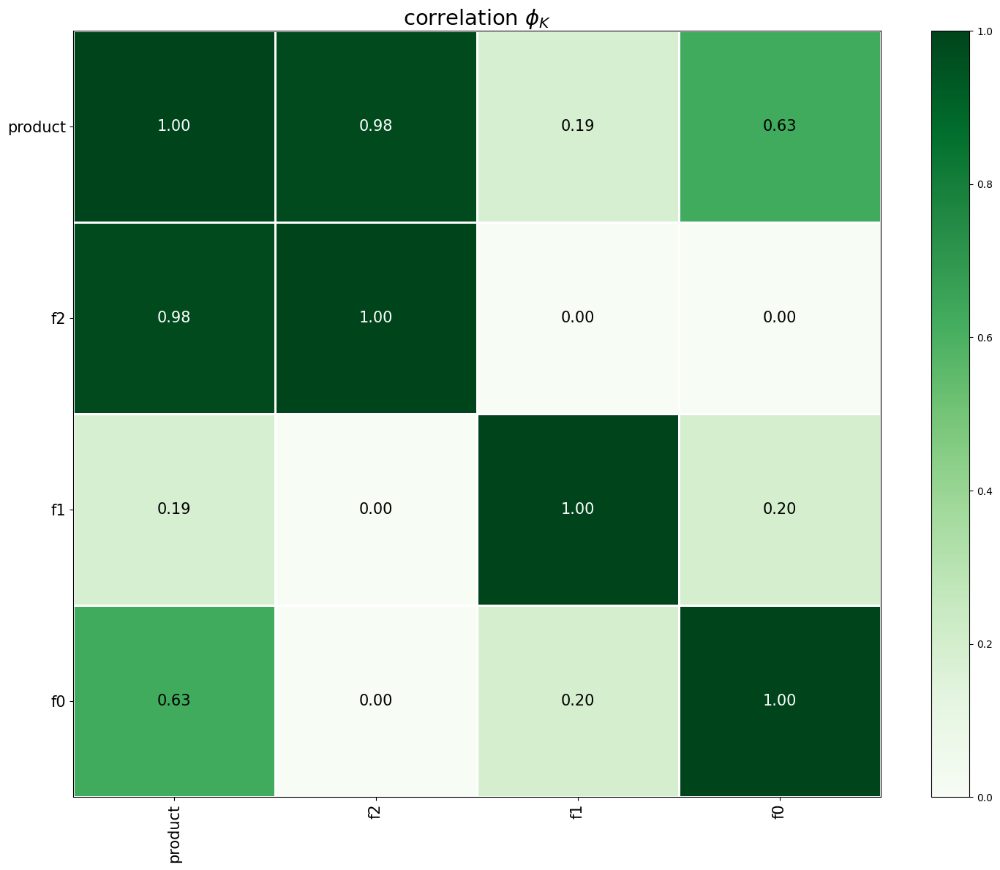

In [40]:
correlation_matrix_phik(geo_data_1)

<b>Вывод</b>

- Наблюдается силная связь между целевым признак и f2.

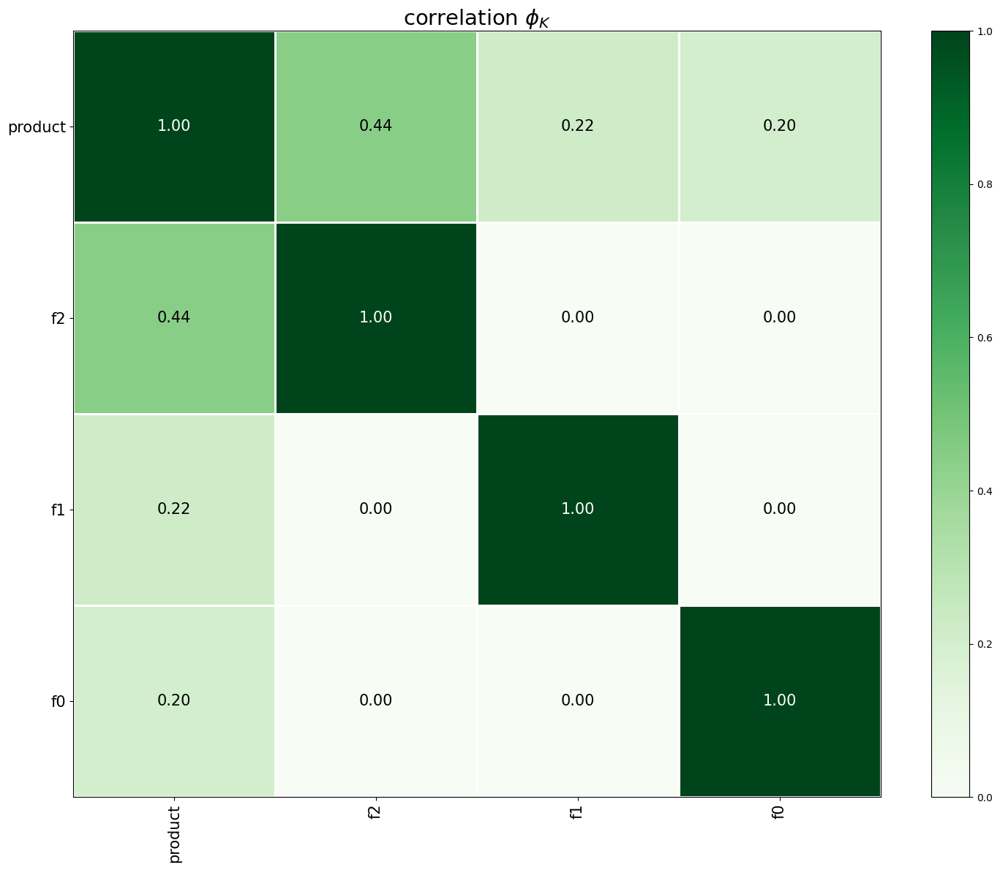

In [41]:
correlation_matrix_phik(geo_data_2)

<b>Вывод</b>

- Связь нет между признаками.

In [42]:
# построим графики
# гистограмму частотности распределения и ящик с усами. 

def hist_box_plot(df):
    # Получаем все числовые столбцы
    num_col = df.select_dtypes(include=['int64', 'float64']).columns.to_list()
    
    for n_col in num_col:
        plt.figure(figsize=(10, 8))
        
        # Гистограмма (сверху)
        plt.subplot(2, 1, 1)  # два ряда, один столбец, первая позиция
        sns.histplot(df[n_col], kde=True)
        plt.title(f'Гистограмма {n_col}')
        plt.xlabel('')  # убираем подпись оси X, чтобы избежать дублирования

        # Boxplot (снизу)
        plt.subplot(2, 1, 2)  # два ряда, один столбец, вторая позиция
        sns.boxplot(x=df[n_col], orient='h')  # горизонтальный boxplot
        plt.title(f'Разброс значений признака {n_col}')
        
        # Подстраиваем расстояния между графиками
        plt.tight_layout()
        plt.show()


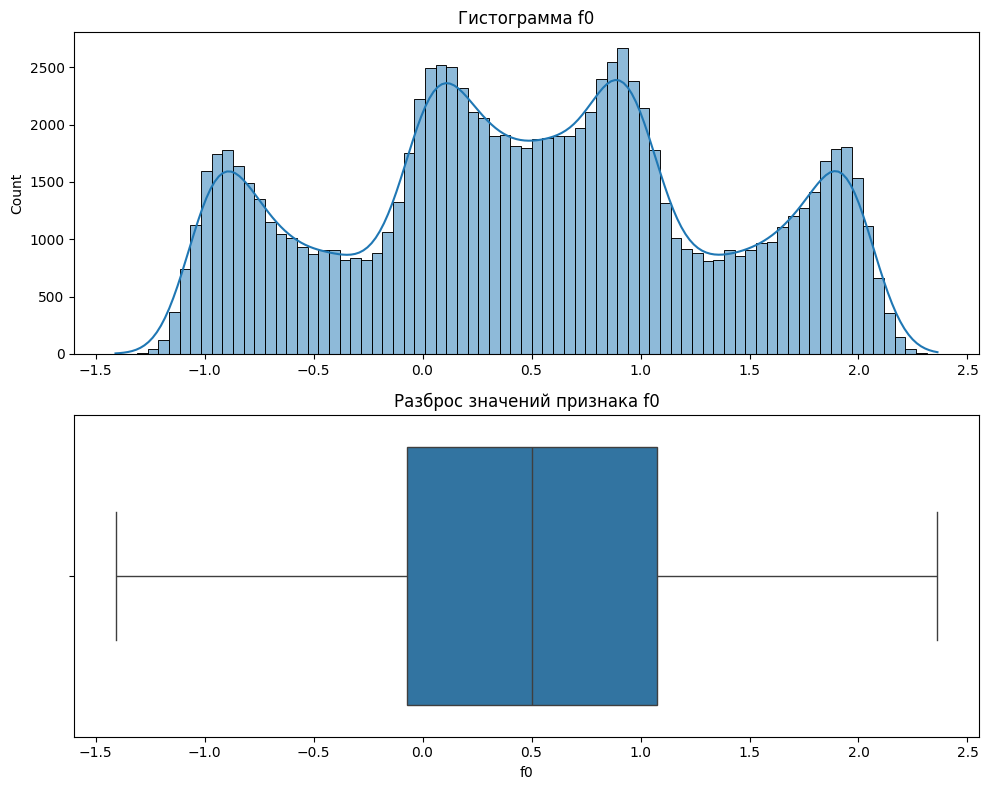

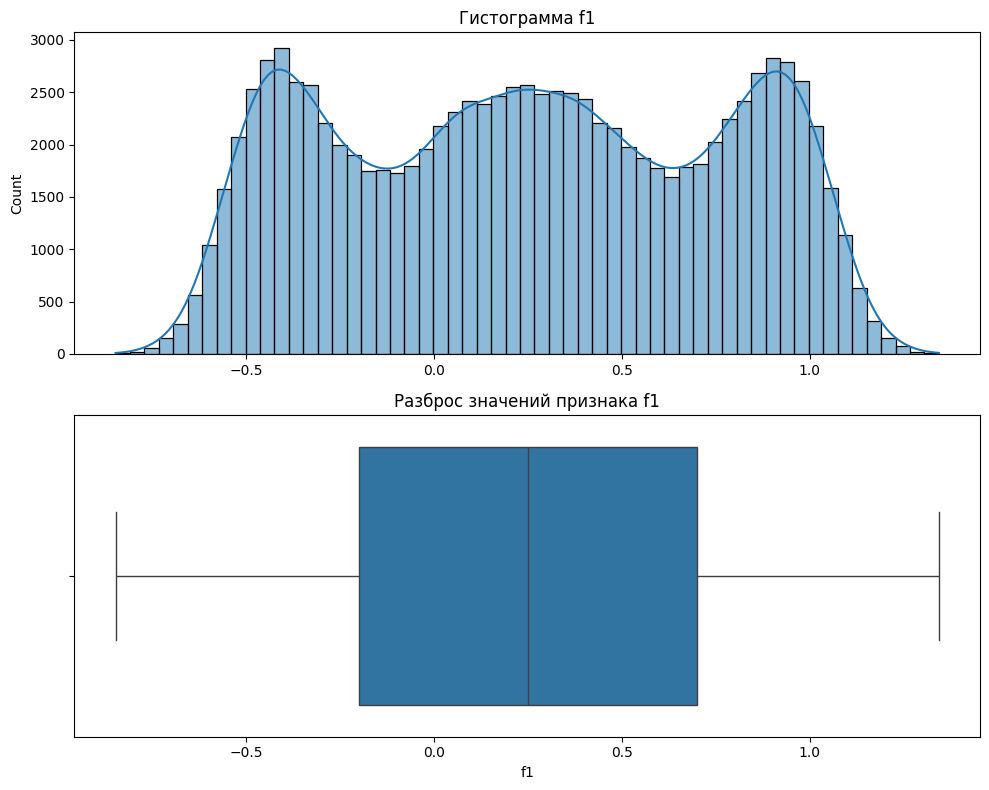

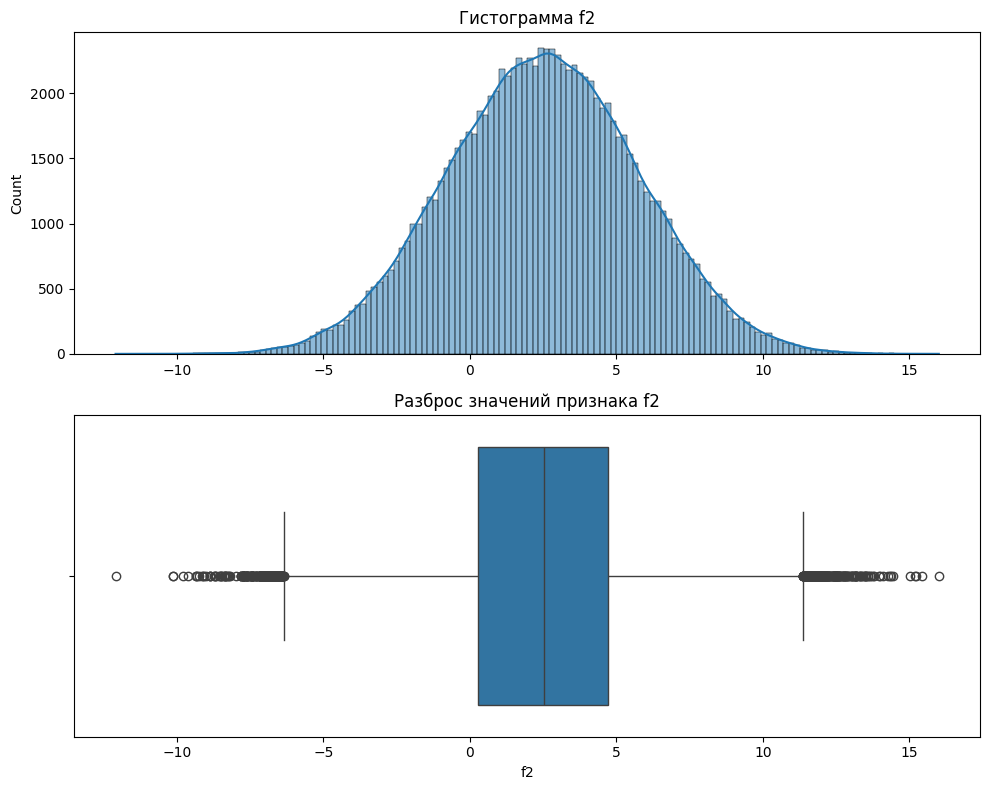

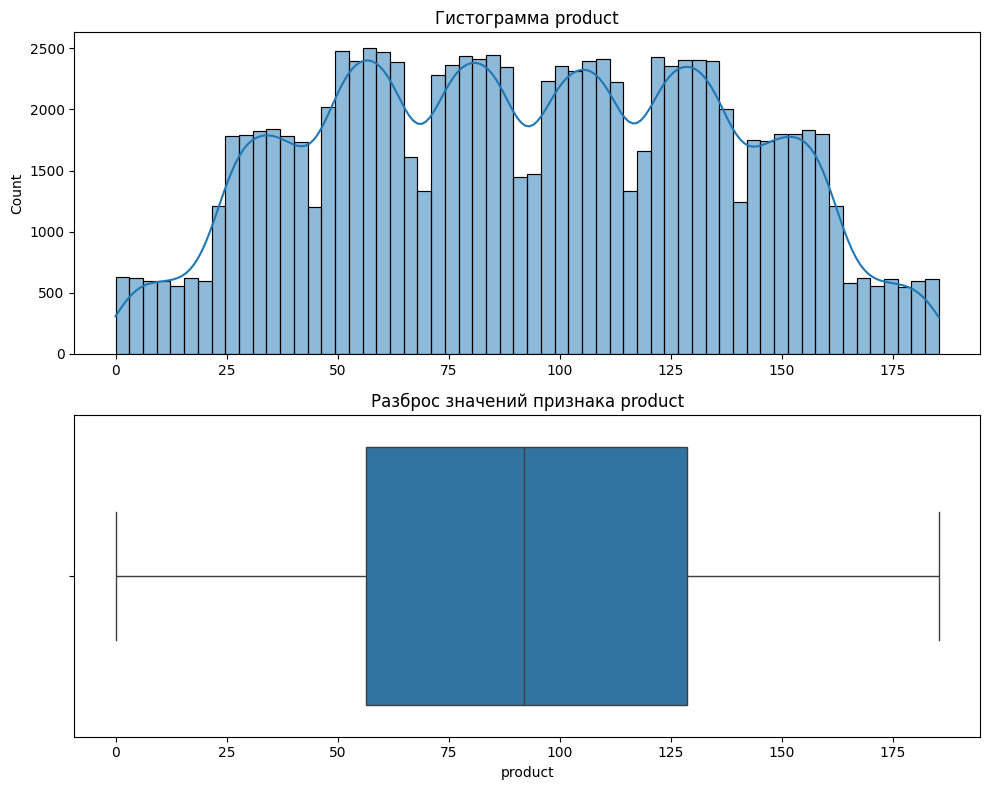

In [43]:
hist_box_plot(geo_data_0)

<b>Вывод</b>

- Признак f2 распределено симметрично.


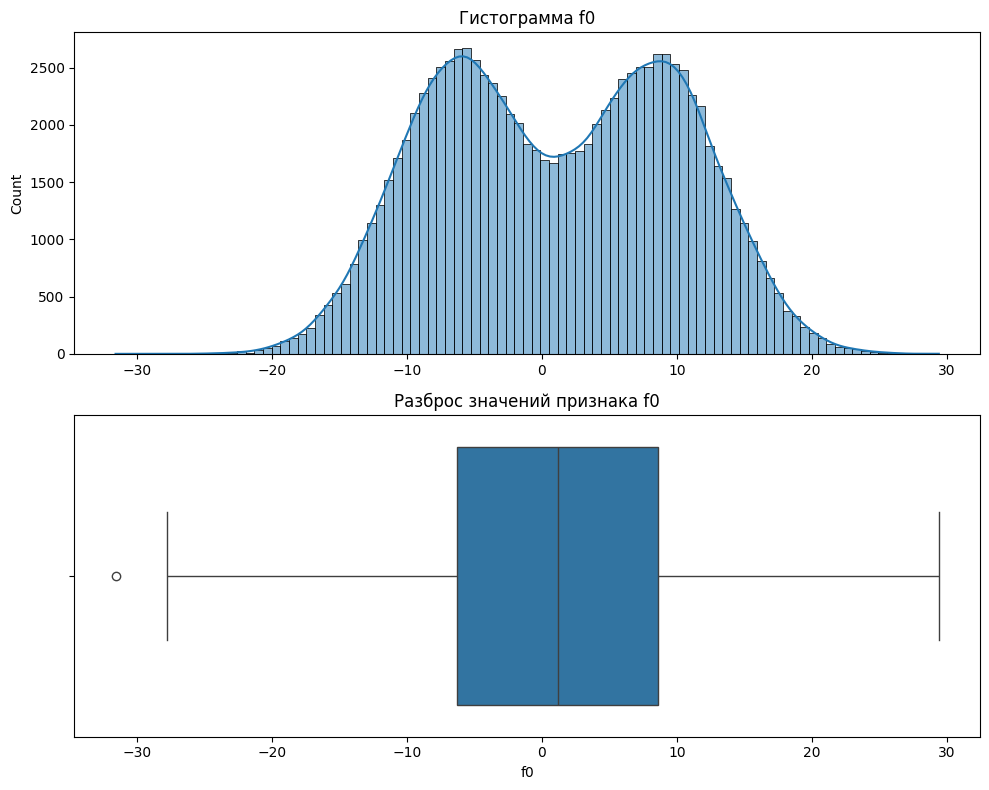

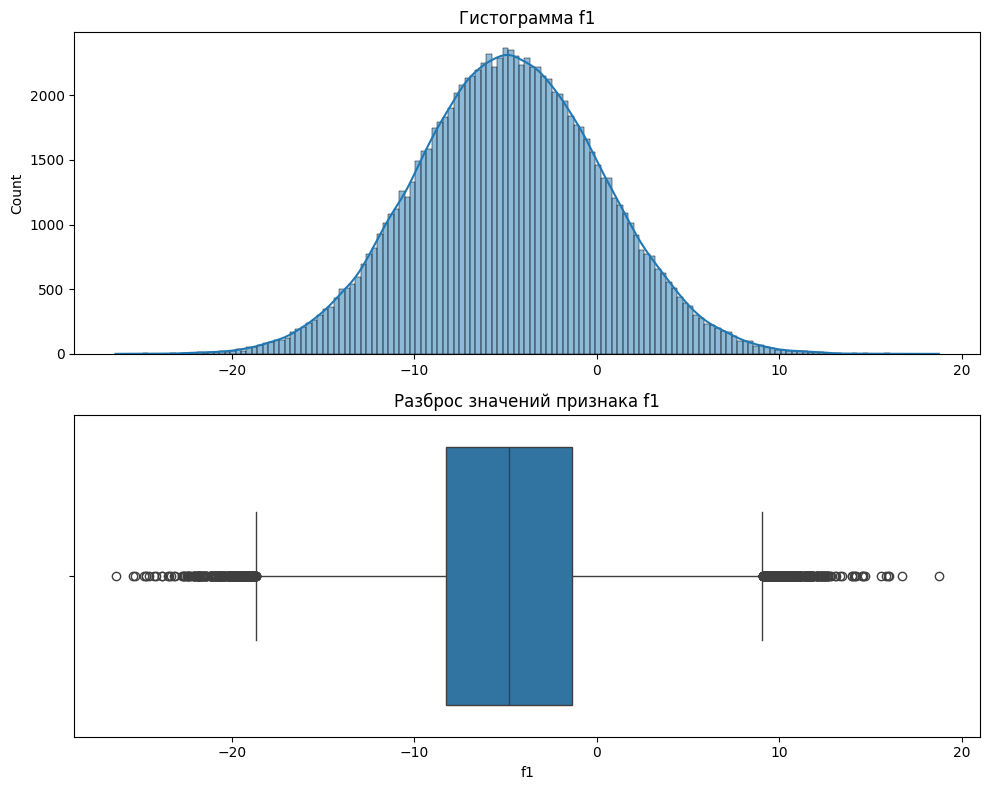

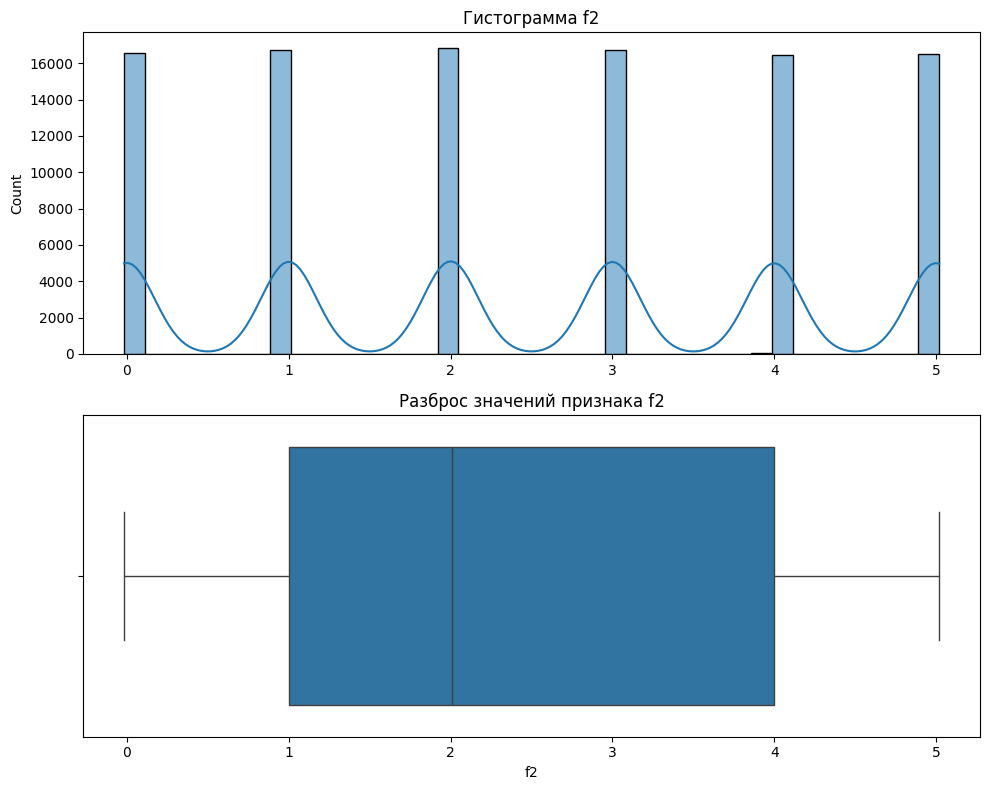

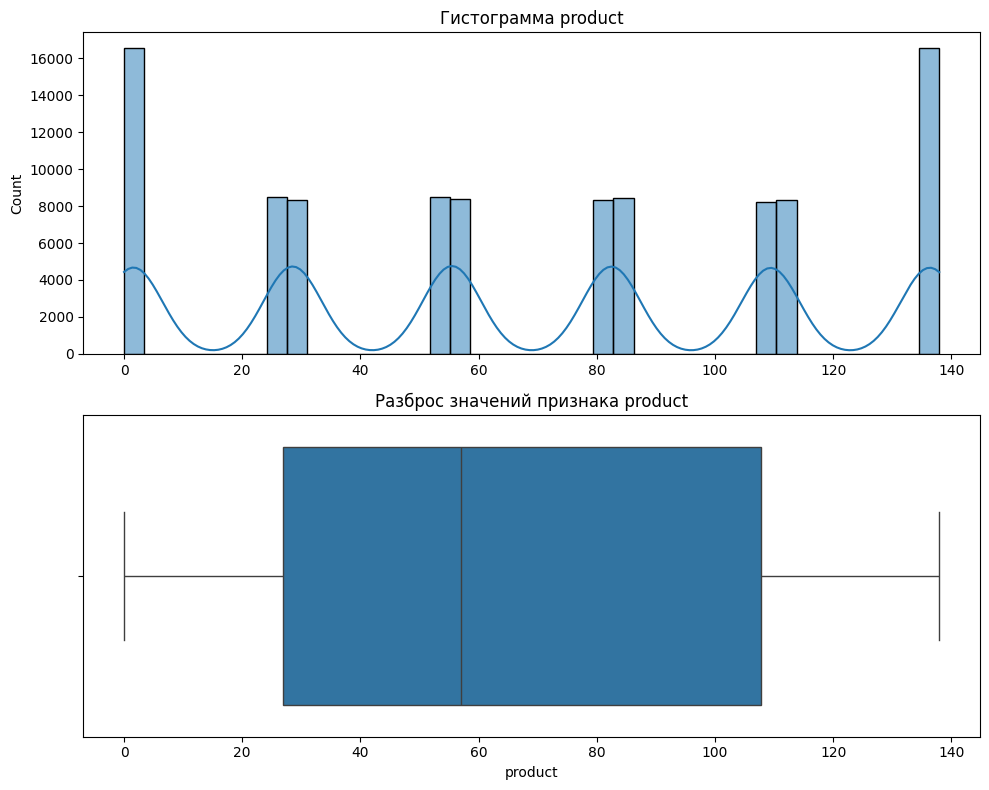

In [44]:
hist_box_plot(geo_data_1)

<b>Вывод</b>

- Признак f0 распределено симметрично.
- По графикам видно почему сильная связь между целевым признакам и f2.


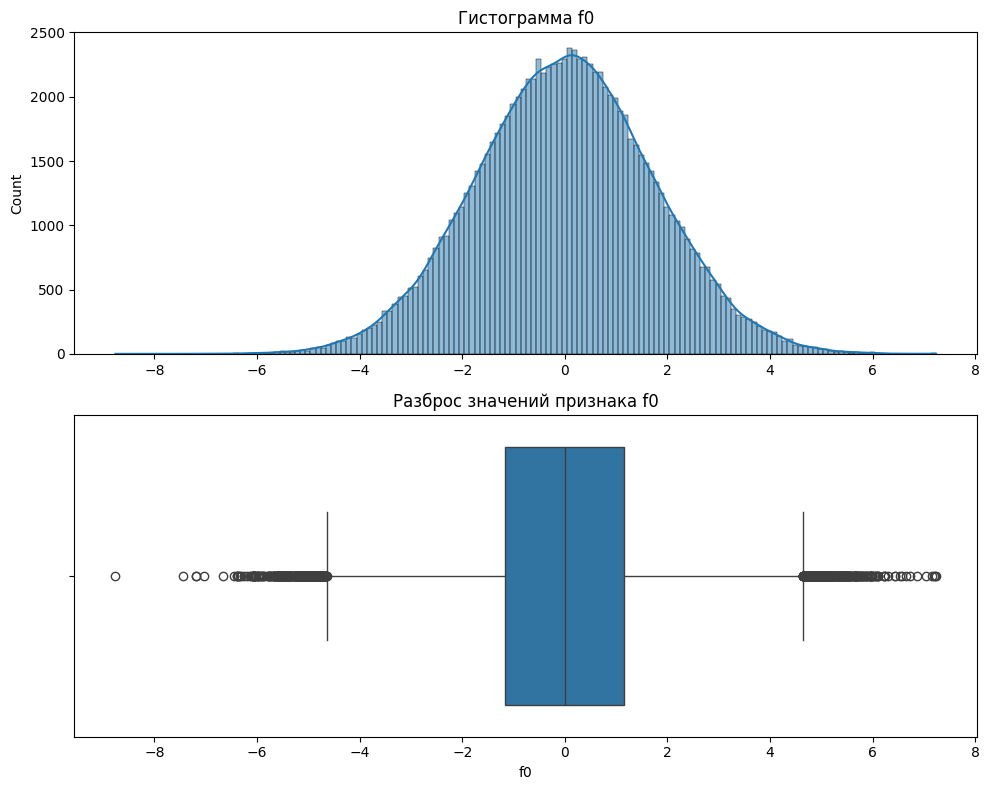

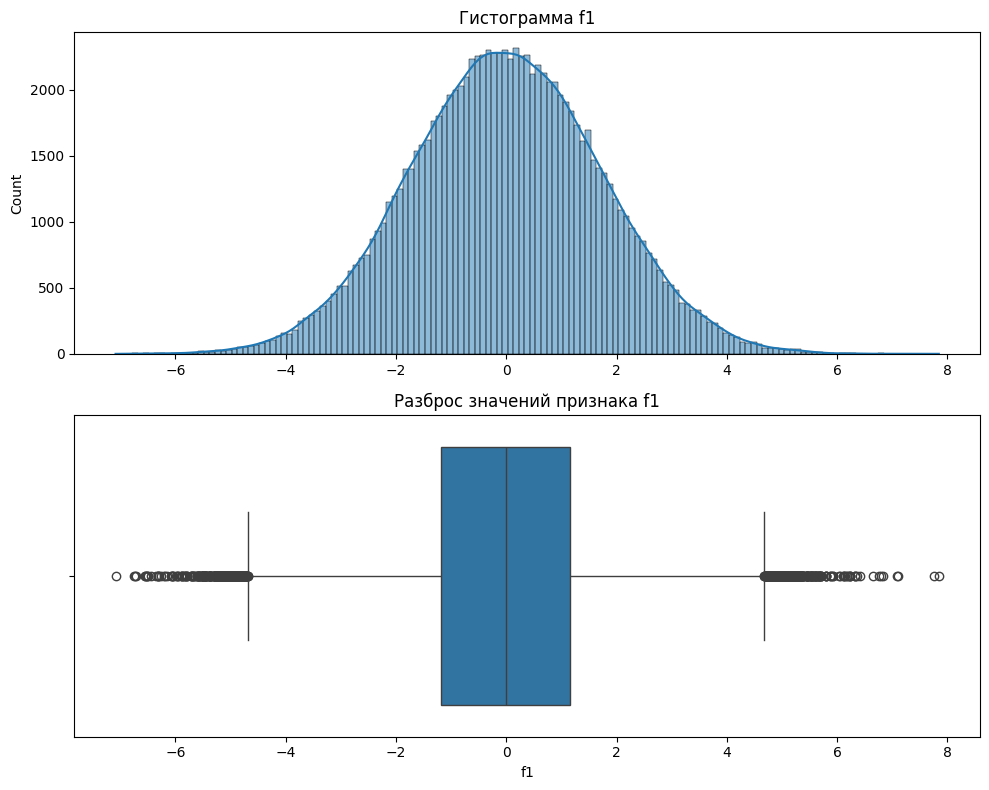

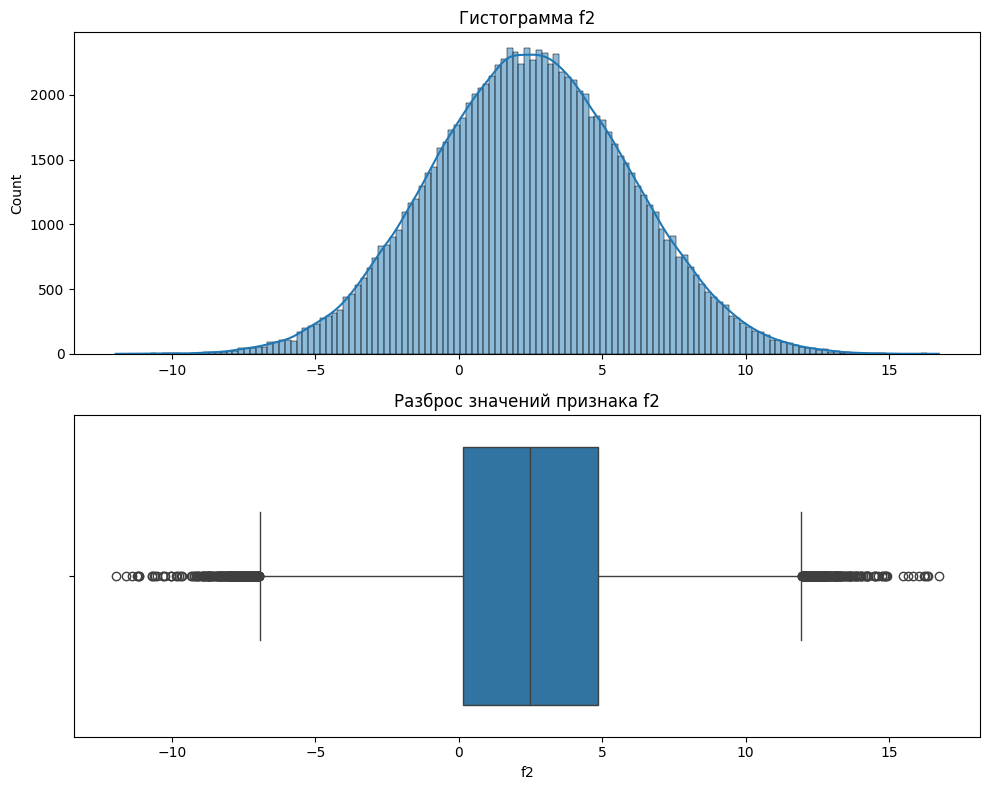

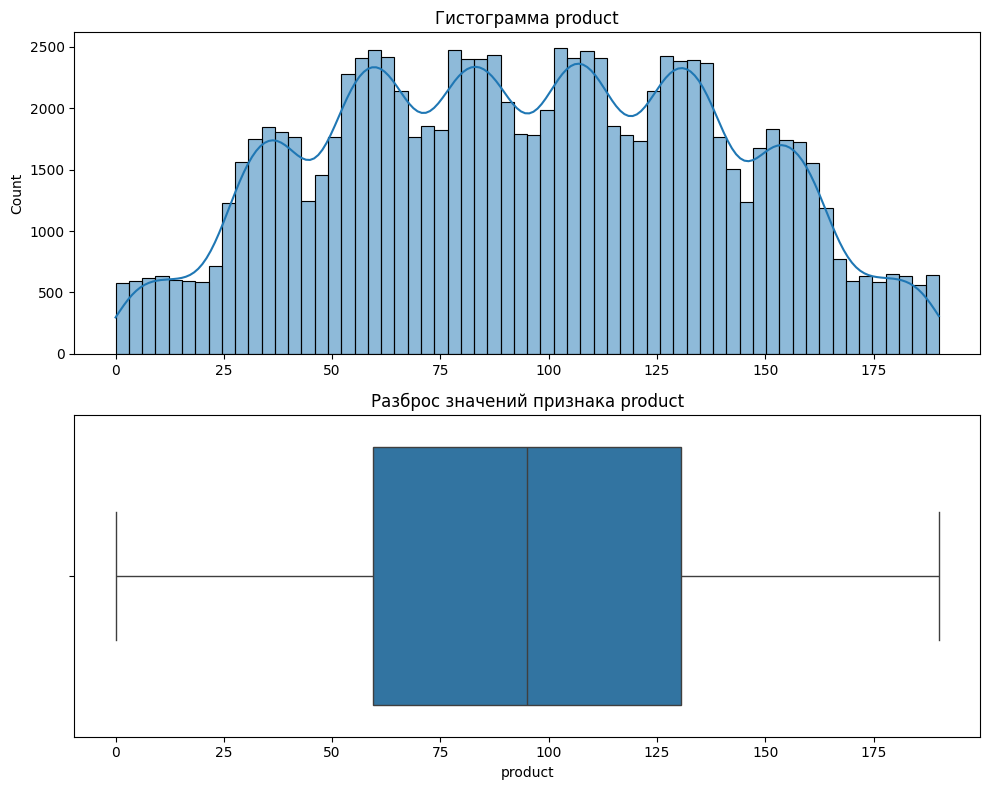

In [45]:
hist_box_plot(geo_data_2)

In [46]:
def plotly_plot(df):
    # Получаем все числовые столбцы
    num_col = df.select_dtypes(include=['int64', 'float64']).columns.to_list()
    for n_col in num_col:
        fig = px.histogram(
        df,
        x = f'{n_col}',
        marginal = 'box',
        opacity = 0.5,
        barmode = 'group',
        title = f'Распределение значений столбца {n_col}')
        fig.show()

In [47]:
plotly_plot(geo_data_0)

<div class="alert alert-success">
<h2> Теория ✔️ <a class="tocSkip"> </h2>

Кстати, если тебе поднадоел стандартный `matplotlib`, попробуй пострить графики с помощью [plotly](https://plotly.github.io/plotly.py-docs/generated/plotly.express.histogram.html)
    
Можно выводить сразу с боксплотами, вот пример
    
```python
import plotly.express as px

fig = px.histogram(
    region,
    x = 'product',
    marginal = 'box',
    opacity = 0.5,
    barmode = 'group',
    title = 'Распределение значений столбца product'
)
fig.show()
```

<b>Вывод</b>

- Признаки распределно идеально.


<b>Вывод</b>

- Данные соответствуют по описанию задачи.
- В датасетах есть  количественные и категориальные признаки.
- Проверена наличие пропущенных значений  их нет.
- Явные  дубликаты нет.
- Признак id есть дубликаты но мы не используем этот признак.
- Построили графики.
- Нашли связь между признаками.

## Шаг 2. Обучите и проверьте модель для каждого региона:

### 2.1. Разбейте данные на обучающую и валидационную выборки в соотношении 75:25.
### 2.2. Обучите модель и сделайте предсказания на валидационной выборке.
### 2.3. Сохраните предсказания и правильные ответы на валидационной выборке.
### 2.4. Напечатайте на экране средний запас предсказанного сырья и RMSE модели.
### 2.5. Проанализируйте результаты.


In [48]:
# Напишем функция для предсказания модели
def predict_model(df):
    X=df.drop(['id','product'], axis=1)
    y=df['product']
    X_train, X_valid, y_train, y_valid = train_test_split(X,y,test_size = TEST_SIZE,  random_state = RANDOM_STATE)
    model=LinearRegression()
    model.fit(X_train,y_train)
    y_pred=model.predict(X_valid)
    rmse_score=root_mean_squared_error(y_pred,y_valid)
    return y_pred,y_valid,rmse_score

In [49]:
# регион geo_data_0
y_pred_0,y_valid_0,rmse_score_0=predict_model(geo_data_0)
print('Средний запас предсказанного сырья для региона 0:',y_pred_0.mean())
print()
print('Качество RMSE модели для региона 0:',rmse_score_0)

Средний запас предсказанного сырья для региона 0: 92.39879990657768

Качество RMSE модели для региона 0: 37.75660035026169


In [50]:
# регион geo_data_1
y_pred_1,y_valid_1,rmse_score_1=predict_model(geo_data_1)
print('Средний запас предсказанного сырья для региона 1:',y_pred_1.mean())
print()
print('Качество RMSE модели для региона 1:',rmse_score_1)

Средний запас предсказанного сырья для региона 1: 68.71287803913762

Качество RMSE модели для региона 1: 0.8902801001028858


In [51]:
# регион geo_data_2
y_pred_2,y_valid_2,rmse_score_2=predict_model(geo_data_2)
print('Средний запас предсказанного сырья для региона 2:',y_pred_2.mean())
print()
print('Качество RMSE модели для региона 2:',rmse_score_2)

Средний запас предсказанного сырья для региона 2: 94.77102387765939

Качество RMSE модели для региона 2: 40.145872311342174


<b>Вывод</b>

- Обучили данные  моделю LinearRegression базовыми настройками.
- Для измерения качество модели использовали root_mean_squared_error
- Лучший регион  средним запасом предсказанного сырья это 2-регион.
- Лучший регион  минимальним rmse_score это 1-регион.
- Метрики регион 0 и 2 почти одинакого. 


## Шаг 3. Подготовьтесь к расчёту прибыли:

### 3.1. Все ключевые значения для расчётов сохраните в отдельных переменных.
### 3.2. Рассчитайте достаточный объём сырья для безубыточной разработки новой скважины. Сравните полученный объём сырья со средним запасом в каждом регионе. 
### 3.3. Напишите выводы по этапу подготовки расчёта прибыли.

 Все ключевые переменные определили в предидушем шаге для каждого региона


In [52]:
# Рассчитаем достаточный объём сырья для безубыточной разработки новой скважины
# Используем данные из условия задачи
BUDGET=10000000000   # Бюджет на разработку скважин в регионе — 10 млрд рублей.
N_WELL=200                 #с помощью машинного обучения выбирают 200 лучших для разработки.
INCOME_WELL=450000     #Доход с каждой единицы продукта составляет 450 тыс. рублей, поскольку объём указан в тысячах баррелей.
volume=BUDGET/N_WELL/INCOME_WELL #достаточный объём сырья для безубыточной разработки новой скважины.
print('Достаточный объём сырья для безубыточной разработки новой скважины:',np.round(volume,2))

Достаточный объём сырья для безубыточной разработки новой скважины: 111.11


<b>Вывод</b>

- Определили ключевые переменные.
- Рассчитали достаточный объём сырья для безубыточной разработки новой скважины.
- Средние запасы в регионах ниже чем рассчитанного  достаточный объём сырья для безубыточной разработки новой скважины.
- Разработка в этих регионах может быть нерентабельним.


## Шаг 4. Напишите функцию для расчёта прибыли по выбранным скважинам и предсказаниям модели:

### 4.1. Выберите скважины с максимальными значениями предсказаний. 
### 4.2. Просуммируйте целевое значение объёма сырья, соответствующее этим предсказаниям.
### 4.3. Рассчитайте прибыль для полученного объёма сырья.

In [53]:
# Напишем функцию для расчёта прибыли
# Используем код с тренажера
def profit(df):
    predict,valid,_=predict_model(df)
    valid=pd.Series(valid)
    predict=pd.Series(predict, index=valid.index)
    predict = predict.sort_values(ascending=False) # Выберим скважины с максимальными значениями предсказаний
    selected = valid[predict.index][:N_WELL] 
    sum_selected=selected.sum()                    # Просуммируем целевое значение объёма сырья, соответствующее этим предсказаниям

    return INCOME_WELL*sum_selected-BUDGET         # Рассчитаем прибыль для полученного объёма сырья

In [54]:
# Рассчитаем прибыль для полученного объёма сырья для каждого региона
print('Прибыль полученного объёма сырья для региона 0:',profit(geo_data_0))
print()
print('Прибыль полученного объёма сырья для региона 1:',profit(geo_data_1))
print()
print('Прибыль полученного объёма сырья для региона 2:',profit(geo_data_2))


Прибыль полученного объёма сырья для региона 0: 3359141114.462179

Прибыль полученного объёма сырья для региона 1: 2415086696.681511

Прибыль полученного объёма сырья для региона 2: 2598571759.374111


<b>Вывод</b>

- Написали функцию для расчёта прибыли.
- Рассчитали прибыль для полученного объёма сырья для каждого региона.
- По прибилю регион 0 оказалось более рентабельно для разработка.

## Шаг 5. Посчитайте риски и прибыль для каждого региона:

### 5.1. Примените технику Bootstrap с 1000 выборок, чтобы найти распределение прибыли.
### 5.2. Найдите среднюю прибыль, 95%-й доверительный интервал и риск убытков. Убыток — это отрицательная прибыль.
### 5.3. Напишите выводы: предложите регион для разработки скважин и обоснуйте выбор.

In [55]:
# Напишем функцию для применинея технику Bootstrap
# Используем код с тренажера

def bootstrap_profit(df):
    predict,valid,_=predict_model(df)
    valid=pd.Series(valid)
    predict=pd.Series(predict, index=valid.index)
    state = np.random.RandomState(12345)

    values = []

    for i in range(1000):
    # Формируем случайную подвыборку с возвращением
        valid_subsample = valid.sample(n=500, replace=True, random_state=state)
   
        predict_subsample = predict[valid_subsample.index]
        predict_subsample = predict_subsample.sort_values(ascending=False) 
        selected_subsample = valid_subsample[predict_subsample.index][:N_WELL]                   
        profit_subsample=INCOME_WELL*selected_subsample.sum() - BUDGET
    # Вычисляем прибыль и добавляем в список values
        values.append(profit_subsample)
    

# Преобразуем список в Series для удобства
    values = pd.Series(values)

# Находим 2.5%-квантиль
    lower = values.quantile(0.025)
# Находим 97.5%-квантиль
    upper = values.quantile(0.975)

# Вычисляем среднее
    mean = values.mean()
# Риск убытков
    risk=(values<0).mean()
# Добавим графики
    plt.figure(figsize=(10, 6))
    plt.hist(values, bins=30, color='lightblue', edgecolor='black')
    plt.axvline(mean, color='blue', linestyle='--', label='Средняя прибыль')
    plt.axvline(lower, color='green', linestyle='--', label='2.5%-квантиль')
    plt.axvline(upper, color='red', linestyle='--', label='97.5%-квантиль')
    plt.xlabel('Прибыль')
    plt.ylabel('Частота')
    plt.title('Гистограмма распределений')
    plt.legend()
    plt.tight_layout()
    plt.show()

# Выводим результаты
    print("Средняя прибыль:", mean)
    print("2.5%-квантиль:", lower)
    print("97.5%-квантиль:", upper)
    print("Риск убытков:", risk)

    

Риски и прибыль для региона 0




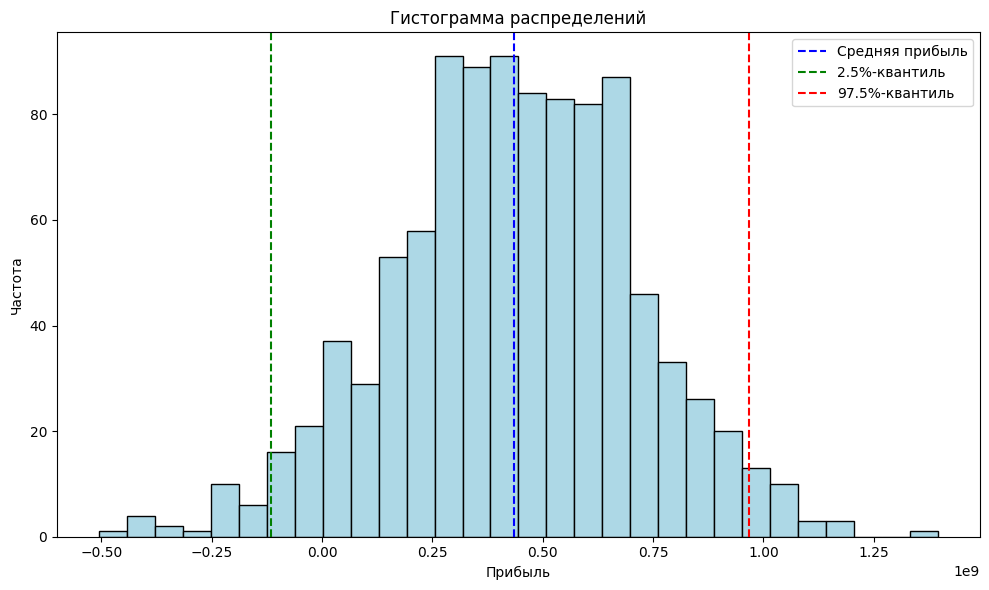

Средняя прибыль: 435933772.1386621
2.5%-квантиль: -116231612.77720818
97.5%-квантиль: 966504180.707376
Риск убытков: 0.061


In [56]:
print('Риски и прибыль для региона 0\n\n')
bootstrap_profit(geo_data_0)

Риски и прибыль для региона 1




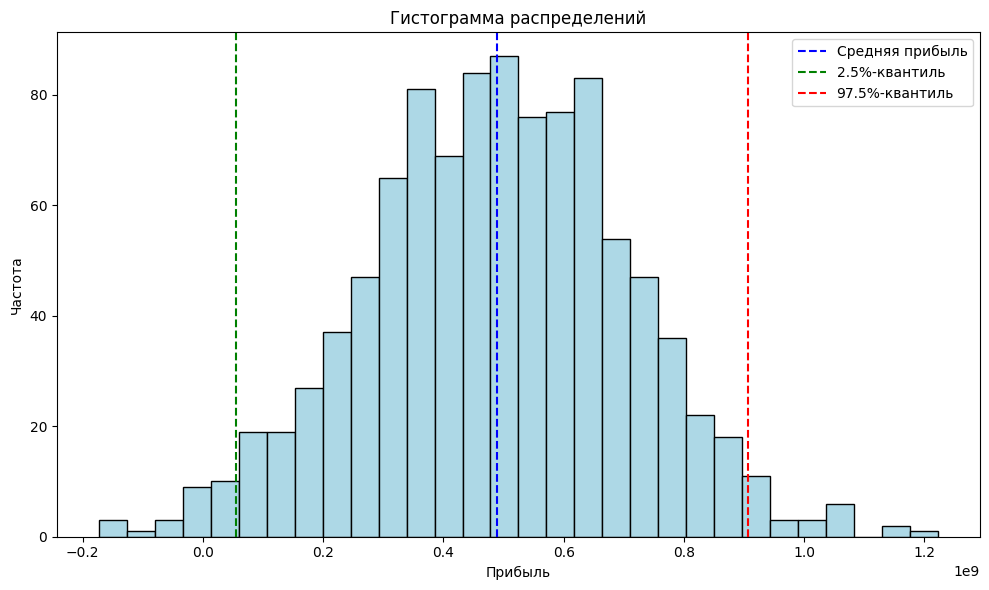

Средняя прибыль: 489661254.41175246
2.5%-квантиль: 55116177.27361494
97.5%-квантиль: 905762650.4248402
Риск убытков: 0.011


In [57]:
print('Риски и прибыль для региона 1\n\n')
bootstrap_profit(geo_data_1)

Риски и прибыль для региона 2




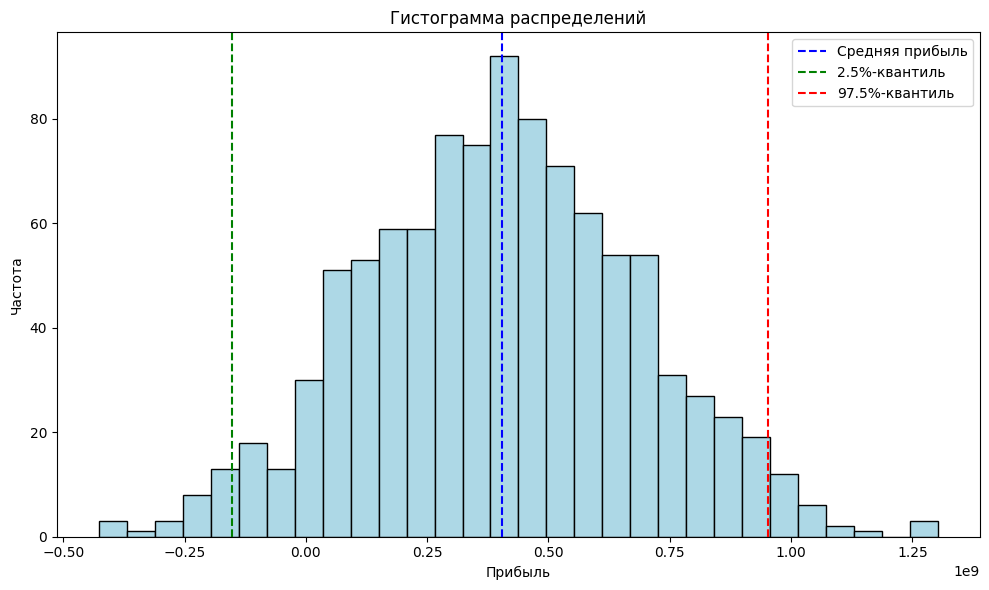

Средняя прибыль: 403687927.86213845
2.5%-квантиль: -153116984.7619049
97.5%-квантиль: 952887416.7078604
Риск убытков: 0.071


In [58]:
print('Риски и прибыль для региона 2\n\n')
bootstrap_profit(geo_data_2)

<b> Общий вывод</b>

- Написали функцию для применения техники Bootstrap.

- Рассчитали риск и прибыль для каждого региона:

  - Cредняя прибыль в регионе 0 достаточно высокая (435,9 млн рублей), риск убытков составляет 6,1%.Это указывает на вероятность убыточных разработок, что может сделать регион менее привлекательным с точки зрения инвестиций. Диапазон прибыли также имеет значительный разброс — возможны как значительные убытки, так и прибыль.

  - Регион 1 показывает наилучшие результаты по средней прибыли (489,7 млн рублей) и имеет самый низкий риск убытков (1,1%).Диапазон доверительного интервала не включает отрицательные значения на уровне 2.5%-квантили, что делает этот регион наиболее надёжным для разработки. Он обладает лучшей сбалансированностью между возможной прибылью и минимальными рисками.
  
  - Регион 2 показывает самую низкую среднюю прибыль (403,7 млн рублей) среди всех регионов. Риск убытков самый высокий — 7,1%. Это делает регион 2 менее предпочтительным для инвестиций, так как высокая вероятность убытков и значительный разброс в диапазоне возможной прибыли делают его наименее стабильным.

- Рекомендую на основе анализа bootstrap и модели:

  - Наиболее прибылным  для разработки является регион 1, так как он имеет наибольшую среднюю прибыль, минимальный риск убытков и качество модели наименьшее.
  
  - Регион 0  требует более тщательного анализа рисков, так как вероятность убытков выше (6,1%).

  - Регион 2 представляет наибольшие риски и наименьшую среднюю прибыль, что делает его менее подходящим для инвестиций.
  